# **PROCESS MINING**

L'obiettivo di questa analisi è quello di individuare e schematizzare il process model sottostante a un campione di event log, verificando poi la conformità del modello ai log, in modo da estrarre ogni informazione possibile riguardante l'efficienza, la presenza o meno di loop, di colli di bottiglia e quant'altro.

In [3]:
#import dei librerie e dei pacchetti necessari
import datetime as dt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from collections import Counter
import plotnine
from plotnine import ggplot, geom_point, aes, theme_bw, coord_flip, scale_y_discrete, theme, element_text, geom_bin2d, ylab, scale_x_datetime
import pm4py

## Import dei log

In [4]:
df = pd.read_csv("Production_Data.csv", sep = ",") #eseguo l'upload degli event log
df = pm4py.format_dataframe(df, case_id= 'Case ID', activity_key='Activity', start_timestamp_key='Start Timestamp', timestamp_key='Start Timestamp')

/jupyter/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecatedWarning:

format_dataframe is deprecated as of 2.3.0 and will be removed in 3.0.0. the format_dataframe function does not need application anymore.



In [5]:
# realizzo una colonna ID con l'indicazione del case ID senza la parola Case 
df['ID'] = df['Case ID'].str.replace('Case','').str.strip() 
df

,Case ID,Activity,Resource,Start Timestamp,Complete Timestamp,Span,Work Order Qty,Part Desc.,Worker ID,Report Type,...,Qty Rejected,Qty for MRB,Rework,case:concept:name,concept:name,time:timestamp,@@index,@@case_index,start_timestamp,ID
0,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-29 23:24:00+00:00,2012-01-30 05:43:00+00:00,006:19,10,Cable Head,ID4932,S,...,0,0,NaN,Case 1,Turning & Milling - Machine 4,2012-01-29 23:24:00+00:00,0,0,2012-01-29 23:24:00+00:00,1
1,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 05:44:00+00:00,2012-01-30 06:42:00+00:00,000:58,10,Cable Head,ID4932,D,...,0,0,NaN,Case 1,Turning & Milling - Machine 4,2012-01-30 05:44:00+00:00,1,0,2012-01-30 05:44:00+00:00,1
2,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 06:59:00+00:00,2012-01-30 07:21:00+00:00,000:22,10,Cable Head,ID4167,S,...,0,0,NaN,Case 1,Turning & Milling - Machine 4,2012-01-30 06:59:00+00:00,2,0,2012-01-30 06:59:00+00:00,1
3,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 07:21:00+00:00,2012-01-30 10:58:00+00:00,003:37,10,Cable Head,ID4167,D,...,0,0,NaN,Case 1,Turning & Milling - Machine 4,2012-01-30 07:21:00+00:00,3,0,2012-01-30 07:21:00+00:00,1
4,Case 1,Turning & Milling Q.C.,Quality Check 1,2012-01-31 13:20:00+00:00,2012-01-31 14:50:00+00:00,001:30,10,Cable Head,ID4163,D,...,1,0,NaN,Case 1,Turning & Milling Q.C.,2012-01-31 13:20:00+00:00,4,0,2012-01-31 13:20:00+00:00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4538,Case 99,Laser Marking - Machine 7,Machine 7- Laser Marking,2012-03-26 09:14:00+00:00,2012-03-26 10:12:00+00:00,000:58,507,Drill,ID0998,D,...,0,0,NaN,Case 99,Laser Marking - Machine 7,2012-03-26 09:14:00+00:00,4538,224,2012-03-26 09:14:00+00:00,99
4539,Case 99,Lapping - Machine 1,Machine 1 - Lapping,2012-03-26 10:12:00+00:00,2012-03-26 12:12:00+00:00,002:00,507,Drill,ID0998,D,...,0,0,NaN,Case 99,Lapping - Machine 1,2012-03-26 10:12:00+00:00,4539,224,2012-03-26 10:12:00+00:00,99
4540,Case 99,Final Inspection Q.C.,Quality Check 1,2012-03-28 17:35:00+00:00,2012-03-28 17:59:00+00:00,000:24,507,Drill,ID4618,D,...,0,0,NaN,Case 99,Final Inspection Q.C.,2012-03-28 17:35:00+00:00,4540,224,2012-03-28 17:35:00+00:00,99
4541,Case 99,Final Inspection Q.C.,Quality Check 1,2012-03-29 08:00:00+00:00,2012-03-29 11:54:00+00:00,003:54,507,Drill,ID4618,D,...,0,0,NaN,Case 99,Final Inspection Q.C.,2012-03-29 08:00:00+00:00,4541,224,2012-03-29 08:00:00+00:00,99


## 1) Analisi ed elaborazione dei log

In [6]:
print(len(df['Case ID'].unique())) #conto il numero di case unici
print(len(df['Activity'].unique())) #conto il numero di attività uniche

225
55


**Elenco delle attività**

In [7]:
df.drop_duplicates(subset='Activity')[["Activity"]]

,Activity
0,Turning & Milling - Machine 4
4,Turning & Milling Q.C.
5,Laser Marking - Machine 7
6,Lapping - Machine 1
10,Round Grinding - Machine 3
12,Final Inspection Q.C.
15,Packing
16,Turning & Milling - Machine 9
17,Turning Q.C.
35,Flat Grinding - Machine 11


**Numero di attività per Case ID**

In [8]:
df.groupby(['Case ID'])["Case ID"].agg(['count'])

,count
Case ID,
Case 1,16
Case 10,24
Case 100,14
Case 101,17
Case 102,30
...,...
Case 95,58
Case 96,9
Case 97,12


**Analisi della durata temporale delle attività**

In [9]:
#converto le due colonne in date
df["Start Timestamp"] = pd.to_datetime(df["Start Timestamp"])
df["Complete Timestamp"] = pd.to_datetime(df["Complete Timestamp"]) 

#costruisco una colonna Duration_Timestamp contenente la durata temporale dell'esecuzione di ogni attività
df["Duration_Timestamp"] = df["Complete Timestamp"] - df["Start Timestamp"]

In [10]:
df["Duration_Timestamp"] = df["Duration_Timestamp"].dt.total_seconds() #converto in secondi la durata temporale delle attività
pd.isnull(df["Duration_Timestamp"]).any() #verifico se esistono attività dalla durata nulla

False

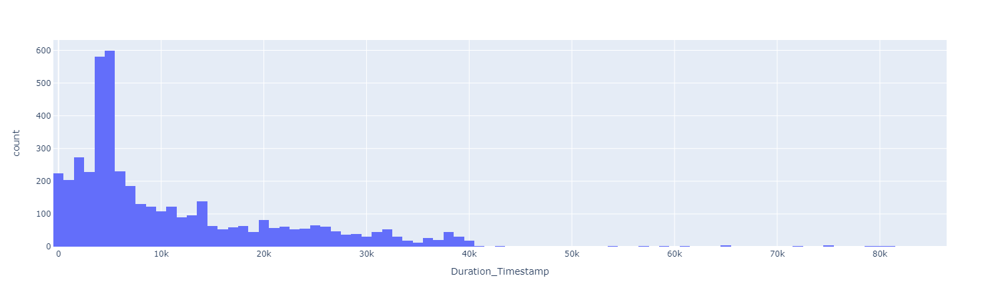

In [11]:
# analizzo la distribuzione temporale delle attività
activities_means = df.groupby(['Activity'])['Duration_Timestamp'].mean()
fig = px.histogram(df['Duration_Timestamp'], x='Duration_Timestamp')
fig.show()

In [12]:
# altro modo per rappresentare graficamente la distribuzione temporale delle attività
#plt.figure(figsize=(15,8))
#sns.distplot(df['Duration_Timestamp'])
#plt.title("Distribuzione temporale della durata media delle attività in secondi");

In [13]:
activity_counts = (df["Activity"]).value_counts() #creo una serie pandas in cui vengono identificate tutte le attività e il numero di occorrenze per ciascuna attività
activities = df["Activity"].unique() #creo un array numpy che contiene l'elenco di tutte le attività presenti nei log

In [14]:
# in questo ciclo for vengono creati i grafici delle distribuzioni temporali delle attività e identificate le variabili statistiche descrittive di ciascuna attività
"""
for attivita in activities:
    log_attivita_i = df[df["Activity"] == attivita]
    print(attivita)
    print(log_attivita_i["Duration_Timestamp"].describe())
    if not log_attivita_i.empty:
        plt.figure(figsize=(8,4))
        fig = px.histogram(log_attivita_i['Duration_Timestamp'], x='Duration_Timestamp')
        fig.show()
    else:    print("no data available")
    """

'\nfor attivita in activities:\n    log_attivita_i = df[df["Activity"] == attivita]\n    print(attivita)\n    print(log_attivita_i["Duration_Timestamp"].describe())\n    if not log_attivita_i.empty:\n        plt.figure(figsize=(8,4))\n        fig = px.histogram(log_attivita_i[\'Duration_Timestamp\'], x=\'Duration_Timestamp\')\n        fig.show()\n    else:    print("no data available")\n    '

#### 1.2 Analisi per case ID

Analisi delle tracce e quindi dei Case ID

In [15]:
# in questo modo ottengo l'elenco completo delle tracce presenti nei log 
"""
vars = pm4py.get_variants(df) 
for k,v in vars.items():
    print(k)
    print(v)
    """

'\nvars = pm4py.get_variants(df) \nfor k,v in vars.items():\n    print(k)\n    print(v)\n    '

Con queto codice riesco a identificare tutte le tipologie di tracce presenti nei log, sempre qua dentro sarebbe possibile vedere quante volte la medesima traccia si presenta, ma con questo dataset non si riesce a farlo perchè gli event log utilizzati identificano 225 tracce univoche

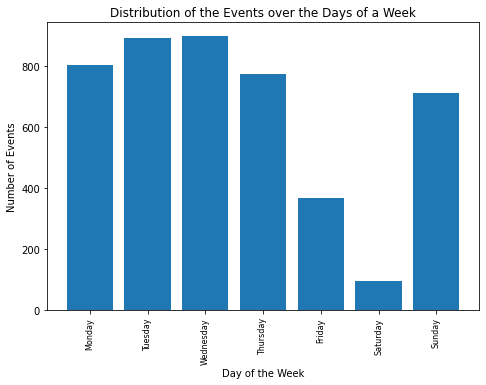

In [16]:
pm4py.view_events_distribution_graph(df, distr_type="days_week")

In [17]:
# Pre-processing per il grafico
case_sorted = df.sort_values(['Complete Timestamp'])

# Creazione delle categorie
case_sorted['Case ID'] = pd.Categorical(case_sorted['Case ID'], categories = case_sorted['Case ID'].drop_duplicates().tolist()[::-1], ordered= True)

/jupyter/lib/python3.6/site-packages/plotnine/utils.py:1246: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



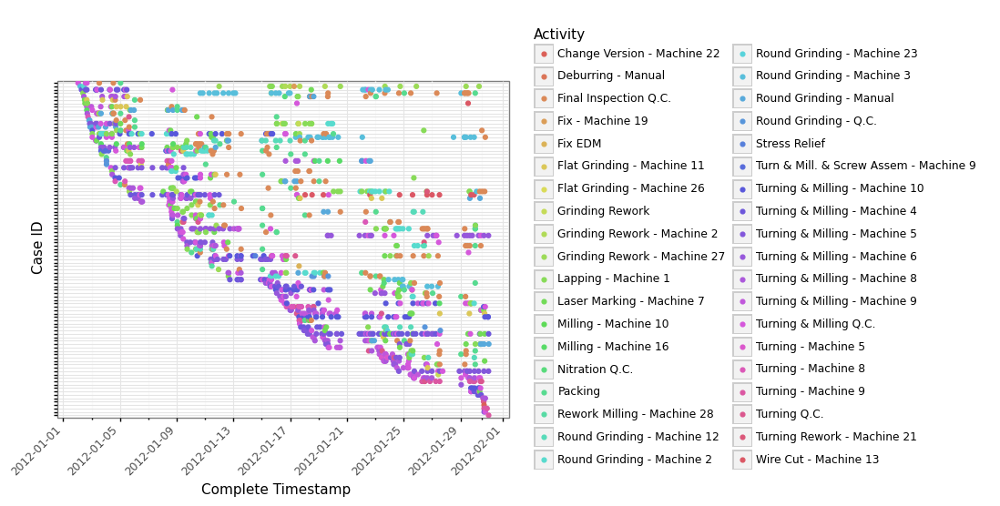

<ggplot: (8731656854013)>

In [18]:
(ggplot(case_sorted[case_sorted['Complete Timestamp'] < '2012-01-31'], aes('Complete Timestamp', 'Case ID', color = 'Activity'))
 + geom_point()
 + theme_bw()
 + scale_y_discrete(labels = "")
 + theme(axis_text_x=element_text(rotation=45, hjust=1)))

In [19]:
case_sorted['time_relative'] = case_sorted['Complete Timestamp'].sub( case_sorted.groupby('Case ID')['Complete Timestamp'].transform('first'))

/jupyter/lib/python3.6/site-packages/plotnine/utils.py:1246: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/jupyter/lib/python3.6/site-packages/plotnine/scales/scale.py:611: PlotnineWarning:

You have changed the transform of a specialised scale. The result may not be what you expect.
Original transform: pd_timedelta
New transform: pd_timedel



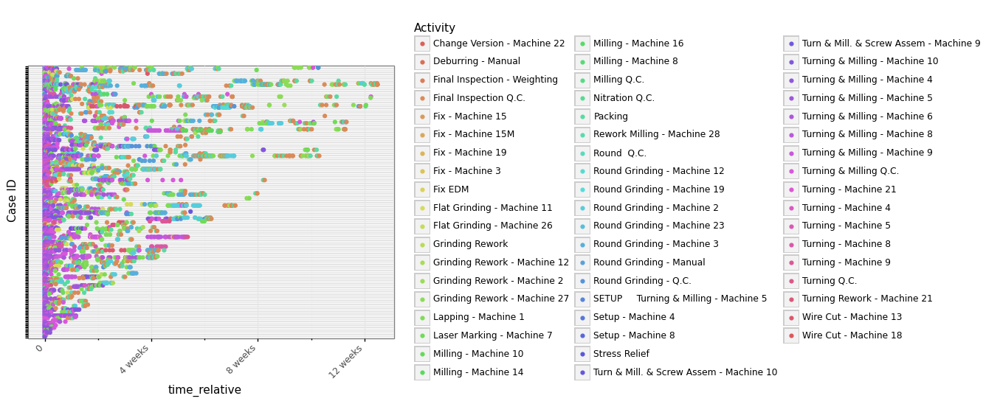

<ggplot: (-9223363305198531847)>

In [20]:
(ggplot(case_sorted, aes('time_relative', 'Case ID', color = 'Activity'))
 + geom_point()
 + theme_bw()
 + scale_y_discrete(labels = "")
 + theme(axis_text_x=element_text(rotation=45, hjust=1)))

Con questa rappresentazione grafica è possibile ottenere due informazioni distinte dai log. La prima è che vi sono numero tracce che hanno un numero estremamente diverso di tracce e che la durata temporale di ogni Case è molto diversa. Infatti si va da una durata temporale di pochi giorni a diverse settimane, arrivando a superare anche i 3 mesi

In [21]:
#in questo comando osservo la durata complesiva di ciascun case ID. In altre parole sto verificando la durata di ciascuna traccia
df_id = pd.DataFrame(df.groupby('ID')['Duration_Timestamp'].sum())
df_id = df_id.rename(columns={'Duration_Timestamp': 'Duration_Timestamp_ID'})
df_id

,Duration_Timestamp_ID
ID,
1,110580.0
10,272640.0
100,75660.0
101,132600.0
102,199800.0
...,...
95,882300.0
96,56280.0
97,52020.0


In [22]:
#creo una copia dei log aggiungendo una colonna che identifica per ciascuna attività la durata complessiva di quella traccia
Data = pd.merge(left = df, right = df_id, on='ID')

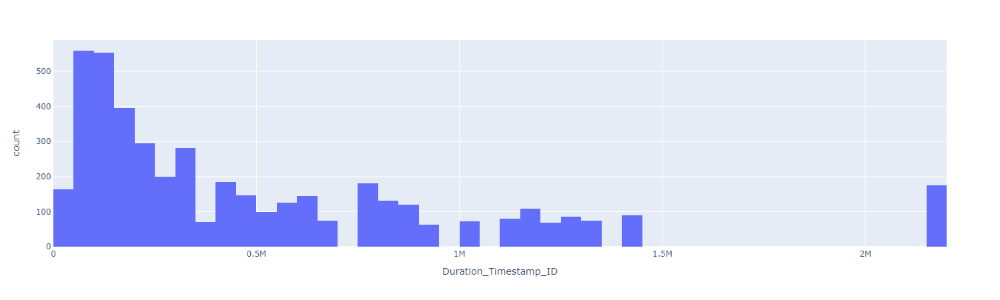

/jupyter/lib/python3.6/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



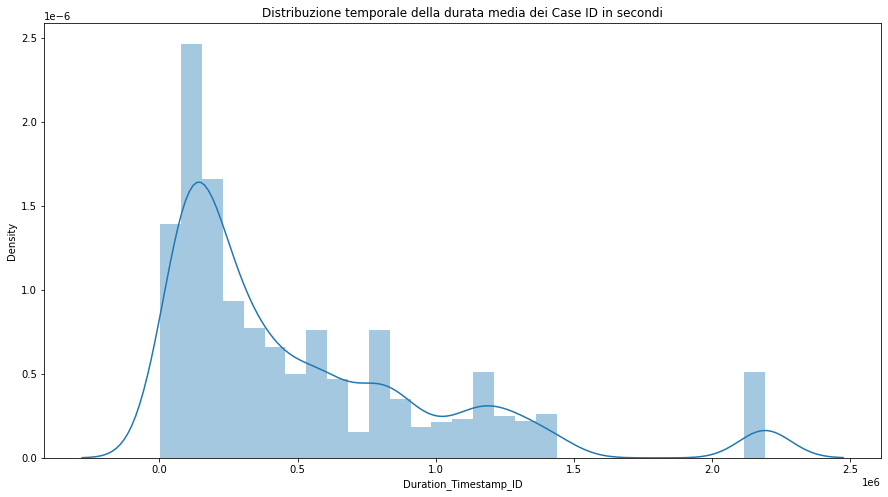

In [23]:
# faccio il plot della distribuzione temporale dei case ID
#1
fig = px.histogram(Data['Duration_Timestamp_ID'], x='Duration_Timestamp_ID')
fig.show()
#2
plt.figure(figsize=(15,8))
sns.distplot(Data['Duration_Timestamp_ID'])
plt.title("Distribuzione temporale della durata media dei Case ID in secondi");

#### 1.3 Filtraggio dei log rispetto alle attività iniziali e finali

Nella fase precedente è stato eseguita un'analisi temporale delle attività e dei log, riscontrando che effettivamente ogni traccia/Case ID ha un numero molto diverso di attività e una durata temporale molto differente. Queste diffrenze sono date dalla possibilità che i log estratti riguardano Case iniziati prima dell'estrazione e terminati nella finestra temorale considerata, ma anche case che iniziano durante la finestra temporale considerata ma non finiscono durante la finestra temporale presa in considerazione. Per questo motivo è di estrema importanza andare ad individuare le attività iniziali e finali de process model in modo da identificare solo quelle tracce che rappresentano il processo completo.

In [24]:
attivita_iniziale = "Turning & Milling - Machine 4"
attivita_finale = "Packing"

filtered_stat_log = pm4py.filter_start_activities(df, {attivita_iniziale})
filtered_log =  pm4py.filter_end_activities(filtered_stat_log, {attivita_finale}) 

Con questo filtro io riesco a individuare e isolare tutte le tracce che iniziano e finiscono con le attività che ho individuato io nel comando precedente, ovvero *attivita_iniziale* e *attivita_finale*. In oltre è possibile specificare più attività iniziali e finali, basta aggiungere l'attività dopo la virgola e sempre all'interno delle parentesi graffe. Ovvero: attivita_iniziale = "Turning & Milling - Machine 4", "Round Grinding - Machine 3"

In [25]:
# questo è un esempio su come filtrare i log rispetto a specifici valori di un attributo 
filtered = pm4py.filter_event_attribute_values(df, 'Worker ID',{'ID4932','ID0998'})
#filtered

#### 1.5 Filtraggio dei log ricercando relazioni specifiche all'interno delle tracce

In [26]:
# questo è un esempio su come filtrare i log ricercando le tracce in cui l'attività 'Packing' viene prima di 'Final Inspection Q.C.' il che è chiaramente un errore

filtered = pm4py.filter_directly_follows_relation(df, [('Packing','Final Inspection Q.C.')])
filtered_df = filtered.groupby('ID')['Duration_Timestamp'].sum()
filtered_df

ID
100      75660.0
106      58620.0
108     132600.0
11      209280.0
110    1024080.0
         ...    
84      151740.0
87     1430040.0
93      476940.0
96       56280.0
97       52020.0
Name: Duration_Timestamp, Length: 89, dtype: float64

Questo risultato ci dice che vi sono ben 89 tracce su 225 in cui l'attività di confezionamento viene prima dell'attività di ispezione finale. Questo è chiaramente un errore, perchè l'ispezione finale andrebbe fatta prima di confezionare il prodotto e non dopo averlo confezionato.  **ATTENZIONE! sembra che in alcune tracce l'attività di confezionamento sia preceduta da quella di ispezione e poi seguita di nuovo da quella di ispezione. Questo può causare distorsione nel filtro precedentemente impostato**

In [27]:
# questo è un esempio su come filtrare i log ricercando le tracce in cui l'attività 'Final Inspection Q.C.' viene prima di 'Packing' 
# la differenza rispetto al filtro di prima è che non necessariamente le due attività sono una seguita dall'altra direttamente, in mezzo possono essere esguite altre attività

filtered = pm4py.filter_eventually_follows_relation(df, [('Final Inspection Q.C.','Packing')])
filtered_df = filtered.groupby('ID')['Duration_Timestamp'].sum()
filtered_df

ID
1      110580.0
10     272640.0
100     75660.0
101    132600.0
102    199800.0
         ...   
91     187500.0
93     476940.0
95     882300.0
97      52020.0
99      54120.0
Name: Duration_Timestamp, Length: 133, dtype: float64

In questo caso è possibile notare che in 133 tracce l'attività di confezionamento segue quella di ispezione finale. In un comando precedentemente eseguito si è visto che in 114 tracce l'attività di confezionamento segue direttamente quella di ispezione finale, in questo modo possiamo concludere che in 19 tracce tra l'attività di confezionamento e quella di ispezione finale vi sono altre attività. Questo è un esempio di come questo sistema di filtri può aiutare a comprendere maggiormente il processo che si sta analizzando.

#### 1.6 Filtraggio dei log rispetto al tempo

In [28]:
#impost il filtro in modo da ottenere gli eventi eseguiti in un arco temporale

filtered = pm4py.filter_time_range(df, dt.datetime(2012, 1, 1), dt.datetime(2012, 1, 30), mode ='events')
filtered_df = filtered.groupby('ID')['Duration_Timestamp'].sum()
filtered_df

ID
1      22740.0
10    257160.0
11    209280.0
12    163680.0
13     31380.0
        ...   
3      53880.0
32    420720.0
34     77100.0
41     62700.0
46      4500.0
Name: Duration_Timestamp, Length: 93, dtype: float64

In [29]:
#impost il filtro in modo da ottenere le tracce completate in un arco temporale

filtered = pm4py.filter_time_range(df, dt.datetime(2012, 1, 1), dt.datetime(2012, 1, 30), mode ='traces_contained')
filtered_df = filtered.groupby('ID')['Duration_Timestamp'].sum()
filtered_df

ID
11     209280.0
13      31380.0
153     14220.0
154     35760.0
155     76080.0
189     51300.0
200     27720.0
203     21360.0
207    380940.0
210    289920.0
211     73020.0
215     73380.0
219     87540.0
22      97020.0
222      3600.0
224      9600.0
227      6960.0
228     48240.0
229     96000.0
231    126000.0
232    138060.0
233    173340.0
236     83640.0
239     96300.0
241     96840.0
243    134580.0
244     83700.0
246    112140.0
248    125340.0
249    212280.0
250    211440.0
252     57480.0
253     64440.0
254     29820.0
255     54000.0
263    162120.0
265    120900.0
27     101460.0
274     79560.0
277    143460.0
Name: Duration_Timestamp, dtype: float64

In [30]:
#impost il filtro in modo da ottenere le tracce che vengono eseguite conteporaneamente in un determinato arco temporale

filtered = pm4py.filter_time_range(df, dt.datetime(2012, 1, 1), dt.datetime(2012, 1, 30), mode ='traces_intersecting')
filtered_df = filtered.groupby('ID')['Duration_Timestamp'].sum()
filtered_df

ID
1      110580.0
10     272640.0
11     209280.0
12     259380.0
13      31380.0
        ...    
3      129720.0
32    1208100.0
34     182460.0
41     107700.0
46      83880.0
Name: Duration_Timestamp, Length: 93, dtype: float64

Il risultato è che 93 tracce vengono eseguite nell'arco temporale di riferimento

# **PROCESS DISCOVERY**

In questa fase si vuole dare una view generale di quelle che sono alcune dei principali metodologie di rappresentazione dei modelli di Business Process Intelligence, ovvero:
- BPMN
- Il process Tree
- Petri Net
- Directly follows graphs
- Euristic net

L'obiettivo qui è identificare le differenze tra le diverse notazioni, senza fare alcun ragionamento sugli algoritmi utilizzati per fare il mining del processo. Infatti, per tutte le rappresentazioni presentate di seguito è stato utilizzato l' "inductive miner", in modo tale da poter confrontare agilmente i processi e le notazioni, senza avere alcun bias relativo all'algoritmo di mining utilizzato. L'unica notazione che non utilizza l'inductive miner è quella di tipo "heuristic net"

#### BPMN

In [31]:
#BPMN 
bpmn_model = pm4py.discover_bpmn_inductive(df)
pm4py.view_bpmn(bpmn_model)

#### Process Tree

In [32]:
#PROCESS TREE
process_tree = pm4py.discover_process_tree_inductive(df)
#pm4py.view_process_tree(process_tree)

#### Petri Net

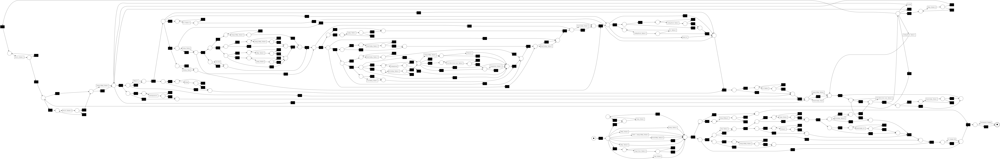

In [51]:
#PETRI NET
net, im, fm = pm4py.discover_petri_net_inductive(df) #il grafico Petri Net in questo caso è stato ottenuto direttamente dagli event log
pm4py.view_petri_net(net, im, fm)

#### DFG

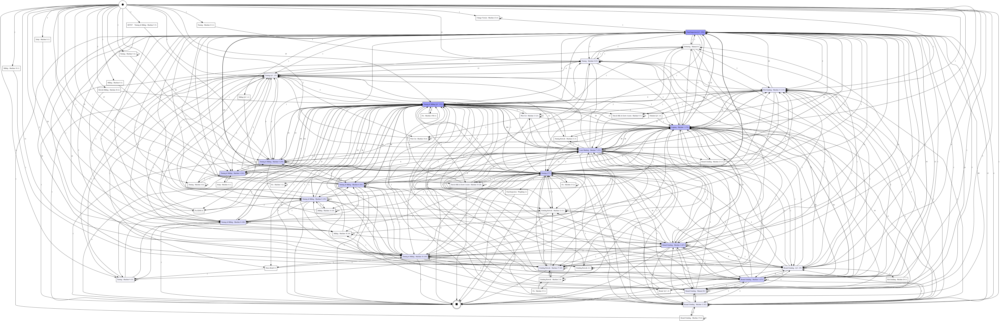

In [34]:
#DIRECTLY FOLLOWS GRAPH
dfg, start_activities, end_activities = pm4py.discover_dfg(df)
pm4py.view_dfg(dfg, start_activities, end_activities)

#DFG
#performance_dfg, start_activities_1, end_activities_2 = pm4py.discover_performance_dfg(df)
#pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)

##### HEURISTIC NET

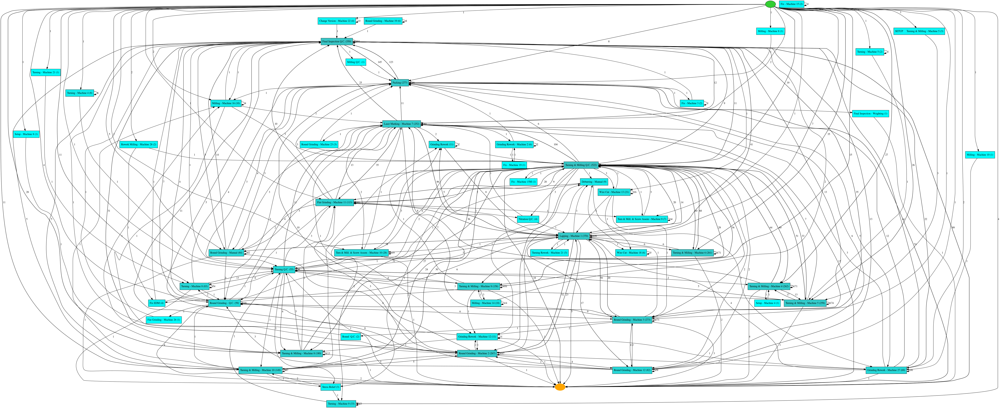

In [35]:
heu_net = pm4py.discover_heuristics_net(df)
pm4py.view_heuristics_net(heu_net)

# **CONFRONTO TRA DIVERSI ALGORITMI DI PROCESS DISCOVERY**

L'obiettivo in questa parte è quello di comparare i diversi algoritmi di process discovery sui log filtrati e valutarne successivamente (nella fase di conformance checking) le performance. Quindi viene data una prima rappresentazione grafica di quello che è l'output dei diversi algoritmi, dopo di che si effettuerà una valutazione su quattro principali driver:
- Il livello di **FITNESS** del modello rispetto ai log
- il livello di **SEMPLICITA'** del modello
- Il livello di **GENERALIZZAZIONE** del modello, quindi la capacità di non overfittare il modello
- Il livello di **PRECISIONE** del modello, ovvero la capacità di non underfittare il modello

## *ALPHA ALGORITHM*

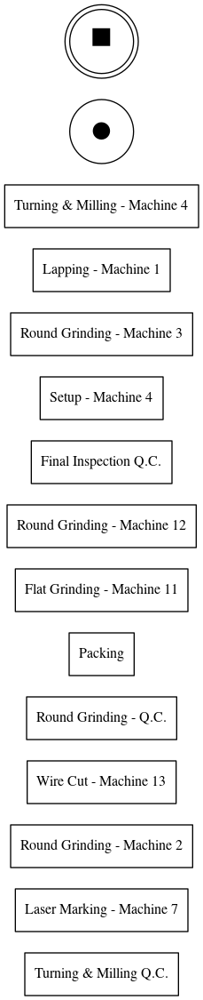

In [36]:
net1, im1, fm1 = pm4py.discover_petri_net_alpha(filtered_log)
pm4py.view_petri_net(net1, im1, fm1)

## *HEURISTICS MINER*

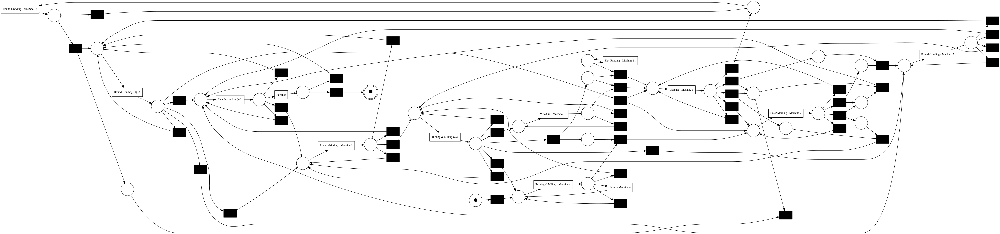

In [37]:
net2, im2, fm2 = pm4py.discover_petri_net_heuristics(filtered_log)
pm4py.view_petri_net(net2, im2, fm2)

# *INDUCTIVE MINER*

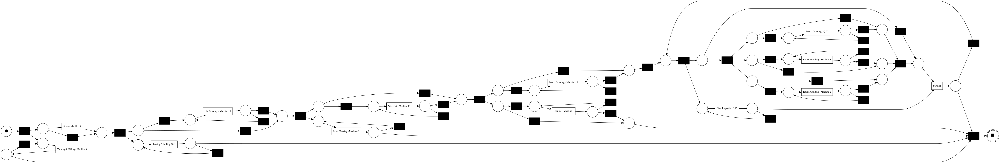

In [38]:
net3, im3, fm3 = pm4py.discover_petri_net_inductive(filtered_log)
pm4py.view_petri_net(net3, im3, fm3)

# *INTEGER LINEAR PROGRAMMING*

In [39]:
#net4, im4, fm4 = pm4py.discover_petri_net_ilp(filtered_log)
#pm4py.view_petri_net(net4, im4, fm4)

Quello proposto di sopra è la rappresentazione grafica del process model ottenuta tramite Directly Follows Graphs rispetto ai log precedentemente filtrati. Si tratta di un process model identificato a partire da log completi, quindi che iniziano con l'attività di *"Turning & Milling - Machine 4"* e che terminano con l'attività di *"Packing"*. Questo filtraggio permette di semplificare notevolmente il processo di rappresentazione del processo, eliminando l'effetto di spaghettifizzazione ottenuto rappresentando integralmente tutti i log. Una volta identificato il process model principale, è necessario effettuare un'analisi delle varianti del processo. I filtered_log saranno quindi ulteriormente splittati in modo da individuare le varianti di questo processo.

# **CONFORMANCE CHECKING** - Valutazione del livello di fitness

Gli algoritmi di conformance cheking che permettono di verificare la coerenza tra gli event log e il modello sono: 
* CAUSAL FOOTPRINT
* TOKEN-BASED REPLY
* ALIGNMENT

## **TOKEN BASED REPLY - Valutazione del livello di Fitness**

### Alpha algorithm

Viene applicato l'algoritmo di token-based reply per valutare il livello di fitness del process model 

In [40]:
fitness_tbr_alpha = pm4py.fitness_token_based_replay(df, net1, im1, fm1)
print(fitness_tbr_alpha)
fitness_tbr_alpha['log_fitness']

replaying log with TBR, completed variants ::   0%|          | 0/221 [00:00<?, ?it/s]

{'perc_fit_traces': 0.0, 'average_trace_fitness': 0.0, 'log_fitness': 0.0, 'percentage_of_fitting_traces': 0.0}


0.0

### Heuristic miner

In [41]:
fitness_tbr_heuristic = pm4py.fitness_token_based_replay(df, net2, im2, fm2)
print(fitness_tbr_heuristic)
fitness_tbr_heuristic['log_fitness']

replaying log with TBR, completed variants ::   0%|          | 0/221 [00:00<?, ?it/s]

{'perc_fit_traces': 0.0, 'average_trace_fitness': 0.7024746270759183, 'log_fitness': 0.83291239544631, 'percentage_of_fitting_traces': 0.0}


0.83291239544631

### Inductive miner

In [42]:
fitness_tbr_inductive = pm4py.fitness_token_based_replay(df, net3, im3, fm3)
print(fitness_tbr_inductive)
fitness_tbr_inductive['log_fitness']

replaying log with TBR, completed variants ::   0%|          | 0/221 [00:00<?, ?it/s]

{'perc_fit_traces': 6.222222222222222, 'average_trace_fitness': 0.881661701761853, 'log_fitness': 0.9153074581656193, 'percentage_of_fitting_traces': 6.222222222222222}


0.9153074581656193

## **ALIGNEMENT**

### Alpha algorithm

In [43]:
#fitness_tbr = pm4py.fitness_alignments(df, net1, im1, fm1)
#precision_tbr = pm4py.precision_alignments(df, net1, im1, fm1)
#print(fitness_tbr)
#print(precision_tbr)

### EURISTIC MINER

In [44]:
#fitness_tbr = pm4py.fitness_alignments(df, net2, im2, fm2)
#precision_tbr = pm4py.precision_alignments(df, net2, im2, fm2)
#print(fitness_tbr)
#print(precision_tbr)

### INDUCTIVE MINER

In [45]:
#fitness_tbr = pm4py.fitness_alignments(df, net3, im3, fm3)
#precision_tbr = pm4py.precision_alignments(df, net3, im3, fm3)
#print(fitness_tbr)
#print(precision_tbr)

# **Valutazione del livello di precisione**

In [46]:
precision_tbr_Alpha = pm4py.precision_token_based_replay(df, net1, im1, fm1)
precision_tbr_Heuristic = pm4py.precision_token_based_replay(df, net2, im2, fm2)
precision_tbr_Inductive = pm4py.precision_token_based_replay(df, net3, im3, fm3)
print(precision_tbr_Alpha, precision_tbr_Heuristic, precision_tbr_Inductive)

replaying log with TBR, completed variants ::   0%|          | 0/3572 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/3572 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/3572 [00:00<?, ?it/s]

0.3877232123479726 0.786328797121852 0.43435002988113947


# **Valutazione del livello di semplicità**

In [47]:
num_archi_Alpha = 1/(len(net1.transitions) + len(net1.places))
num_archi_Heuristic = 1/(len(net2.transitions) + len(net2.places))
num_archi_Inductive = 1/(len(net3.transitions) + len(net3.places))

print(num_archi_Alpha, num_archi_Heuristic, num_archi_Inductive)

0.06666666666666667 0.010752688172043012 0.009900990099009901


Il process model migliore viene valutato sulla base di quattro variabili, ovvero il livello di fitness rispetto agli Event Log, il livello di precisione, il livello di semplicità e il livello di generalizzazione. 

In [48]:
matrice_valutazione = pd.DataFrame([[fitness_tbr_alpha['log_fitness'],precision_tbr_Alpha,num_archi_Alpha],[fitness_tbr_heuristic['log_fitness'],precision_tbr_Heuristic,num_archi_Heuristic],[fitness_tbr_inductive['log_fitness'],precision_tbr_Inductive,num_archi_Inductive]])
matrice_valutazione.columns = ['Perc_fitness', 'Perc_precision', 'N_archi/nodi']
matrice_valutazione.index = ['Alpha_algorithm', 'Heuristic_miner', 'Inductive_miner']
matrice_valutazione

,Perc_fitness,Perc_precision,N_archi/nodi
Alpha_algorithm,0.000000,0.387723,0.066667
Heuristic_miner,0.832912,0.786329,0.010753
Inductive_miner,0.915307,0.434350,0.009901


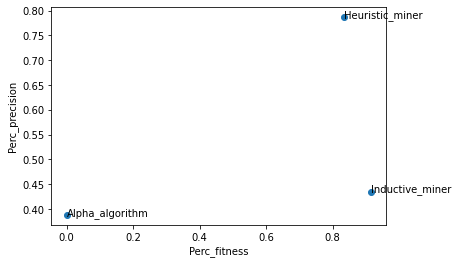

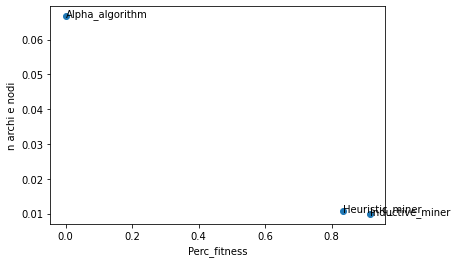

In [49]:
righe = matrice_valutazione.index

perc_fitness = matrice_valutazione['Perc_fitness']
perc_precision = matrice_valutazione['Perc_precision']
n_archinodi = matrice_valutazione['N_archi/nodi']

### Primo grafico ###
plt.scatter(perc_fitness, perc_precision)

for i, riga in enumerate(righe):
    plt.text(perc_fitness[i], perc_precision[i], riga)


plt.xlabel('Perc_fitness')
plt.ylabel('Perc_precision')
plt.show()

### Secondo grafico ###
plt.scatter(perc_fitness, n_archinodi)

for i, riga in enumerate(righe):
    plt.text(perc_fitness[i], n_archinodi[i], riga)


plt.xlabel('Perc_fitness')
plt.ylabel('n archi e nodi')
plt.show()

##### Dai grafici indicati di seguito è possibile individuare come l'Heuristic miner è l'algoritmo che permette di estrarre il modello migliore. Infatti confrontando i tre modelli permette di ottenere un livello di fitness abbastanza buono e di poco inferiore all'Inductive miner, ma a differenza dell'inductive miner, il modello estratto dall'Heuristic miner è molto più preciso e presenta un minor numero di archi e di nodi, quindi più semplice.